# Tutorial: How to calibrate the OpenHSI camera


This is not for genral use. add warning.

In [ ]:
#all_hardware

In [ ]:
from openhsi.calibrate import SettingsBuilderMixin, sum_gaussians, specta_pt_contoller
from openhsi.cameras import LucidCamera
import numpy as np

import holoviews as hv
hv.extension('bokeh',logo=False)

class CalibrateLucidCamera(SettingsBuilderMixin,LucidCamera):
    pass

# json_path='cals/cam_settings_lucid_214302972.json'
# pkl_path="cals/openhsi_214302972.pkl"

json_path='cals/cam_settings_lucid_template.json'
pkl_path=''

json_path_target='cals/OpenHSI-07/OpenHSI-07_settings_Mono8_bin1.json'
pkl_path_target='cals/OpenHSI-07/OpenHSI-07_calibration_Mono8_bin1.pkl'

spt=specta_pt_contoller()

## Find illuminated sensor area

The vertical directon/y axis of the detector array corrspeonds the across-track direction of the sensor. If the image of slit is shorter then the heigh we can crop the top and bottom to save bandwidth/disk space (similar to letterboxing video).

There are two ways to do this, croping after the fact using row_minmax or by setting up a window on the sensor. Setting up a window will reduce the ammount of data transfered from the sensor and can improve maximum framerate depending on the sensor so is recomended.

### 1. Take a flat field

First step is to provide a uniform illumination to the slit, ideally spectrally broadband, like a halogen lamp or the sun.

In [ ]:
spt.selectPreset(10000)

with CalibrateLucidCamera(json_path=json_path,
                     pkl_path=pkl_path_target,
                     processing_lvl=-1,
                    ) as cam:
    
    hvim_flat=cam.retake_flat_field(show=True)
    hvim_flat.opts(width=600,height=600,axiswise=True)
    
    hvim_row_minmax=cam.update_row_minmax()
    hvim_row_minmax.opts(width=600,height=600,axiswise=True)
    
    cam.update_resolution()
    
    # Use Row min max to update window
    windowheight=math.ceil((cam.settings["row_slice"][1]-cam.settings["row_slice"][0] + 8) / 4.) * 4 
    print("Windowheight {}".format(windowheight))

    cam.settings["win_resolution"]=[windowheight, cam.settings["resolution"][1]]
    cam.settings["win_offset"]=[math.ceil((cam.settings["row_slice"][0]-4) / 4.)*4, cam.settings["win_offset"][1]]

    # json_path='cals/cam_settings_lucid_'+cam.deviceSettings["DeviceUserID"].value+'.json'
    # pkl_path='cals/openhsi_'+cam.deviceSettings["DeviceUserID"].value+'.pkl'
    
    cam.dump(json_path=json_path_target,pkl_path=pkl_path_target)
    
hvim_row_minmax+hvim_flat

NameError: name 'hvim_flat' is not defined

### 2. Retake flat field with windowing.

In [ ]:
spt.selectPreset(10000)

with CalibrateLucidCamera(json_path=json_path_target,
                     pkl_path=pkl_path_target,
                     processing_lvl=-1,
                    ) as cam:

    hvim_flat=cam.retake_flat_field(show=True)
    hvim_flat.opts(width=600,height=600,axiswise=True)
    
    hvim_row_minmax=cam.update_row_minmax()
    hvim_row_minmax.opts(width=600,height=600,axiswise=True)
    
    cam.update_resolution()
    cam.dump(json_path=json_path_target,pkl_path=pkl_path_target)

spt.turnOffLamp()

hvim_row_minmax+hvim_flat

### 3. Take Arc and setup wavelength scale.

In [ ]:
#hardware

with CalibrateLucidCamera(json_path=json_path_target,
                     pkl_path=pkl_path_target,
                     processing_lvl=-1,
                    ) as cam:
    cam.deviceSettings['Gain'].value=25.0
    hvimg=cam.retake_HgAr(show=True)

    hvimg.opts(width=800,height=800)
    print(cam.calibration["HgAr_pic"].max())
    smile_fit_hv=cam.update_smile_shifts()

    wavefit_hv=cam.fit_HgAr_lines(top_k=10,brightest_peaks=[435.833,546.074,(579.960+579.066)/2,763.511])
    
    # Use wavecal to narrow spetral range.
    waveminmax=[430,860]
    waveminmax_ind = [np.argmin(np.abs(cam.calibration["wavelengths_linear"]-λ)) for λ in waveminmax]

    window_width = math.ceil((waveminmax_ind[1]-waveminmax_ind[0] + 8) / 4.) * 4
    offset_x = math.ceil((waveminmax_ind[0]-4) / 4.)*4
    print("Window Width {}, offset x {}".format(window_width,offset_x))

    cam.settings["win_resolution"][1]=window_width
    cam.settings["win_offset"][1]= offset_x

    cam.dump(json_path=json_path_target,pkl_path=pkl_path_target)

(hvimg + smile_fit_hv + wavefit_hv).opts(shared_axes=False)

### Redo Arc with window.

In [ ]:
with CalibrateLucidCamera(json_path=json_path_target,
                     pkl_path=pkl_path_target,
                     processing_lvl=-1,
                    ) as cam:
    cam.deviceSettings['Gain'].value=20.0
    hvimg=cam.retake_HgAr(show=True)

    hvimg.opts(width=800,height=800)
    print(cam.calibration["HgAr_pic"].max())
    smile_fit_hv=cam.update_smile_shifts()

    wavefit_hv=cam.fit_HgAr_lines(top_k=10,brightest_peaks=[435.833,546.074,(579.960+579.066)/2,763.511])

    cam.dump(json_path=json_path_target,pkl_path=pkl_path_target)

(hvimg + smile_fit_hv + wavefit_hv).opts(shared_axes=False)

255.0


:Layout
   .Image.I   :Image   [x,y]   (z)
   .Curve.I   :Curve   [x]   (y)
   .Overlay.I :Overlay
      .Curve.I    :Curve   [x]   (y)
      .Curve.II   :Curve   [x]   (y)
      .Curve.III  :Curve   [x]   (y)
      .Curve.IV   :Curve   [x]   (y)
      .Curve.V    :Curve   [x]   (y)
      .Curve.VI   :Curve   [x]   (y)
      .Curve.VII  :Curve   [x]   (y)
      .Curve.VIII :Curve   [x]   (y)
      .Curve.IX   :Curve   [x]   (y)
      .Curve.X    :Curve   [x]   (y)
      .Curve.XI   :Curve   [x]   (y)

### 3. Get Integrating Sphere data for radiance calibration

4D datacube with coordinates of cross-track, wavelength, exposure, and luminance.

In [ ]:
lum_preset_dict={0:1, 1000:2, 2000:3, 3000:4, 4000:5, 5000:6, 6000:7, 7000:8, 8000:9, 9000:10, 10000:11, 20000:12, 25000:13, 30000:15, 35000:15, 40000:16}

luminances = np.fromiter(lum_preset_dict.keys(), dtype=int)
exposures = [0, 5, 8, 10, 15, 20]

with CalibrateLucidCamera(json_path=json_path_target,
                     pkl_path=pkl_path_target,
                     processing_lvl=-1,
                    ) as cam:
    
    cam.calibration["rad_ref"] = cam.update_intsphere_cube(exposures, luminances, noframe=20, lum_chg_func=spt.selectPreset)
    cam.dump(json_path=json_path_target,pkl_path=pkl_path_target)
    

Luminance = 0 Cd/m^2. Place lens cap on and press enter to continue. 
Luminance = 0 Cd/m^2. Remove lens cap and place on int sphere and press enter to continue. 


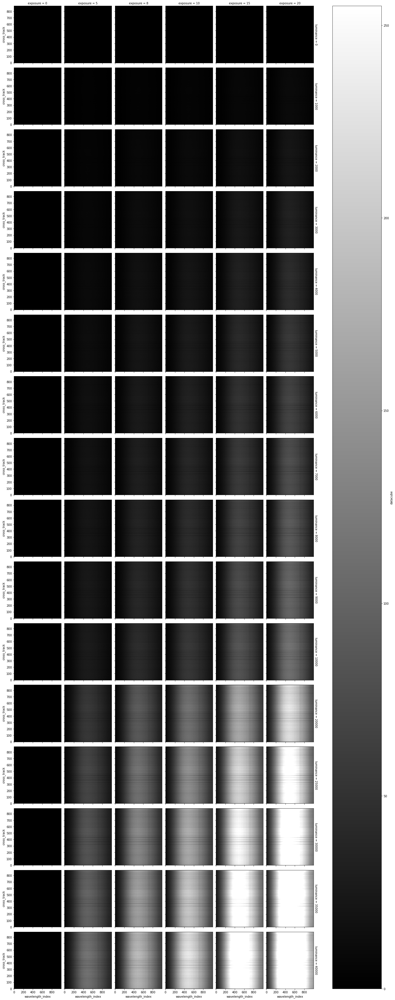

In [ ]:
cam.calibration["rad_ref"].datacube.plot(y="cross_track", x="wavelength_index", col="exposure", row="luminance",cmap="gray")

In [ ]:
#hardware
print("rad_ref is {} MB".format(cam.calibration["rad_ref"].datacube.size/1024/1024 *4))

rad_ref is 323.73046875 MB


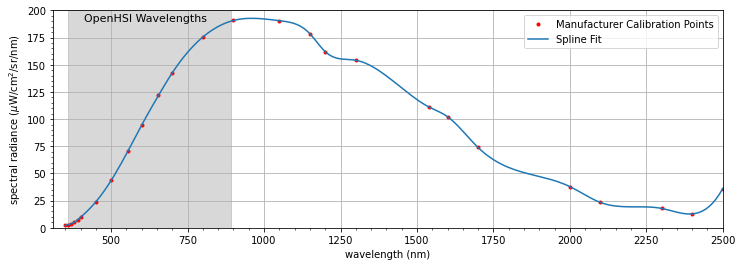

In [ ]:
cam.update_intsphere_fit()
cam.dump(json_path=json_path_target,pkl_path=pkl_path_target)